# Importing required python libraries

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
%matplotlib inline

# Analysis,Design and Development 

# Eyeballing a sample claibration image

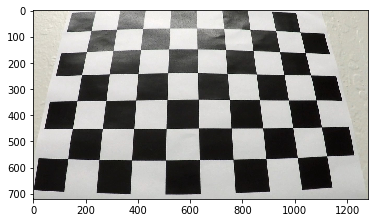

In [2]:
img=mpimg.imread('../CarND-Advanced-Lane-Lines/camera_cal/calibration3.jpg')
plt.imshow(img)

# Building a function for camera distortion correction based on chess board calibration matrix

In [3]:
def find_camera_distortion(_calibrationFileGlob,_chessBoardDimentions):    
    _chessBoardColumns=_chessBoardDimentions[0]
    _chessBoardRows=_chessBoardDimentions[1]
    
    #Arrays to store object points and image points from all the images
    objectpoints=[] #3D points in the real world space 
    imagepoints=[] #2D points in the image plane
    
    objp=np.zeros((_chessBoardRows*_chessBoardColumns,3),np.float32)
    objp[:,:2]=np.mgrid[0:_chessBoardColumns,0:_chessBoardRows].T.reshape(-1,2) #x,y coordinates

    #images= glob.glob('../CarND-Advanced-Lane-Lines/camera_cal/calibration*.jpg')
    images= glob.glob(_calibrationFileGlob)
    for fname in images:
        #read in each image
        img=mpimg.imread(fname) 
        
        #Convert to grayscale
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        
        #Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (_chessBoardColumns, _chessBoardRows), None)
        # If found, draw corners
        if ret == True:
            imagepoints.append(corners)
            objectpoints.append(objp)
        #Draw and display the corners
        #cv2.drawChessboardCorners(img, (_chessBoardColumns, _chessBoardRows), corners, ret)
        #cv2.imshow(fname,img)
        #cv2.waitKey(500)
    #cv2.destroyAllWindows()
    #calculate the camera matrix, distortion coefficient, camera vectors
    ret,mtx,dist,rvecs,tvecs=cv2.calibrateCamera(objectpoints,imagepoints,gray.shape[::-1],None,None)
    return ret,mtx,dist,rvecs,tvecs

### Testing distortion coefficients(dist) and matrix(mtx)

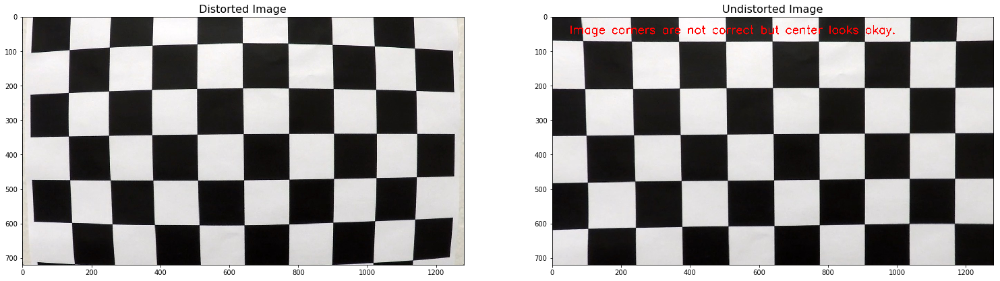

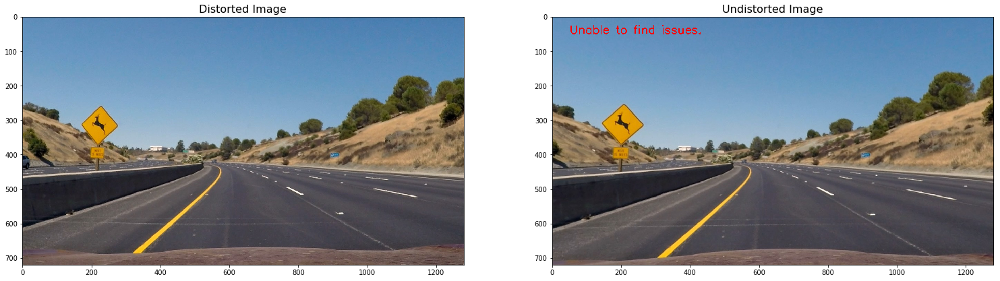

In [4]:
_chessBoardRows=6
_chessBoardColumns=9
ret,mtx,dist,rvecs,tvecs=find_camera_distortion('../CarND-Advanced-Lane-Lines/camera_cal/calibration*.jpg',\
                                                [_chessBoardColumns,_chessBoardRows])

#testing camera calibration
imgTest=mpimg.imread('../CarND-Advanced-Lane-Lines/camera_cal/calibration1.jpg')
dst=cv2.undistort(imgTest,mtx,dist,None,mtx)
cv2.putText(dst, 'Image corners are not correct but center looks okay.', (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1.1, (255, 0, 0), 2)

#gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion
f, (ax1, ax2) = plt.subplots(1, 2, sharey=False,figsize=(20,20))
ax1.imshow(imgTest)
ax1.set_title('Distorted Image', fontsize=16)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=16)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#testing with sample image
imgTest=mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/test2.jpg')
dst=cv2.undistort(imgTest,mtx,dist,None,mtx)
cv2.putText(dst, 'Unable to find issues.', (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1.1, (255, 0, 0), 2)# not a good way to write text on a image

#gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion
f, (ax1, ax2) = plt.subplots(1, 2, sharey=False,figsize=(20,20))
ax1.imshow(imgTest)
ax1.set_title('Distorted Image', fontsize=16)
ax2.imshow(dst)
ax2.set_title('Undistorted Image', fontsize=16)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


# Gradients and color transforms

In [5]:
def Sobelx_Threshold(img,threshold=(20,100)):
    # Grayscale image
    # NOTE: we already saw that standard grayscaling lost color information for the lane lines
    # Explore gradients in other colors spaces / color channels to see what might work better
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # Sobel x
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))

    # Threshold x gradient
    thresh_min = threshold[0]
    thresh_max = threshold[1]
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= thresh_min) & (scaled_sobel <= thresh_max)] = 1
    return sxbinary
#====================
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, dir_thresh=(0, np.pi/2)):
    #Calculate gradient direction
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobely=np.absolute(sobely)
    abs_sobelx=np.absolute(sobelx)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    absgraddir = np.arctan2(abs_sobely, abs_sobelx)
    #Apply threshold
    # 5) Create a binary mask where direction thresholds are met
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= dir_thresh[0]) & (absgraddir <= dir_thresh[1])] = 1
    # Return the binary image
    return dir_binary

# Color and Sobel thresholding

In [6]:
def color_sobal_gradientthresholding(img, h_thresh=(15, 100),s_thresh=(90, 255),\
                                     R_thresh = (200, 255), sx_thresh=(20, 100)):
    img = np.copy(img)
    
    R_channel = img[:,:,0]
    G_channel = img[:,:,1]
    B_channel = img[:,:,2]
    
    # Convert to HLS color space and separate the V channel    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    h_channel = hls[:,:,0]
    s_channel = hls[:,:,2]
    
    
    # Threshold R color channel
    R_binary = np.zeros_like(R_channel)
    R_binary[(R_channel > R_thresh[0]) & (R_channel <= R_thresh[1])] = 1
        
    # Threshold S color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Threshold H color channel
    h_binary = np.zeros_like(h_channel)
    h_binary[(h_channel >= h_thresh[0]) & (h_channel <= h_thresh[1])] = 1
    
    # Applying SobelX and thresholding 
    sxbinary=Sobelx_Threshold(img,threshold=(20,100))
    
    #applying direction gradient and thresholding
    dir_binary = dir_threshold(img, sobel_kernel=15, dir_thresh=(0.7, 1.3))
    combined_binary=np.zeros_like(sxbinary)
    combined_binary[
        (sxbinary==1) &(dir_binary==1) & (R_binary==1)
        |((s_binary==1) & (h_binary==1))
    ]=1
    return combined_binary

# Checking color and sobel thresholding 

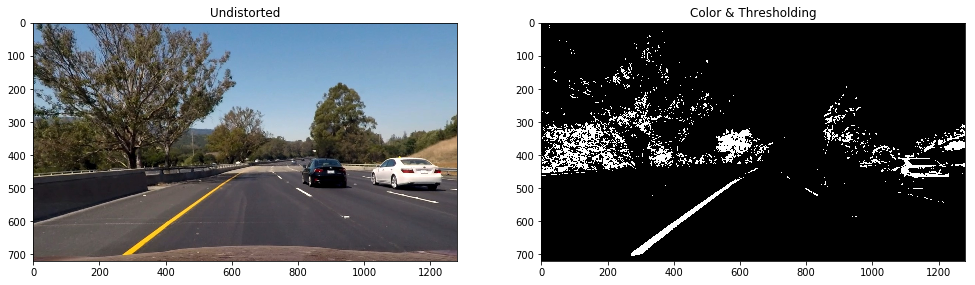

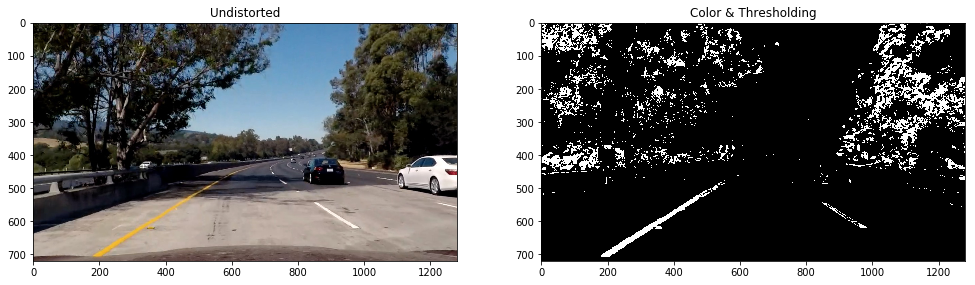

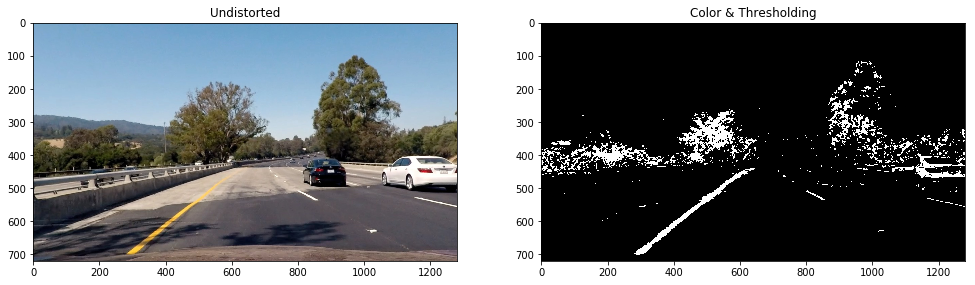

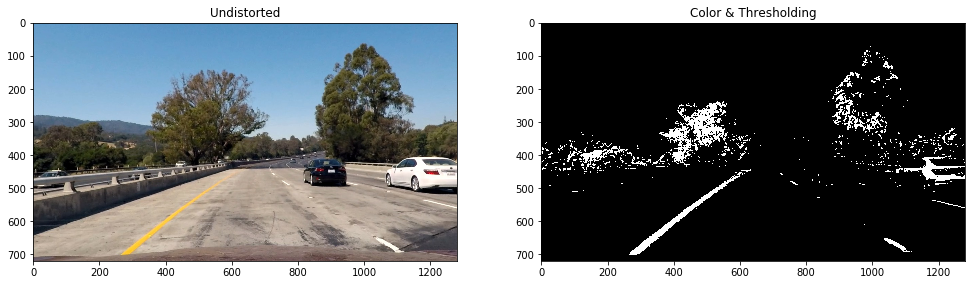

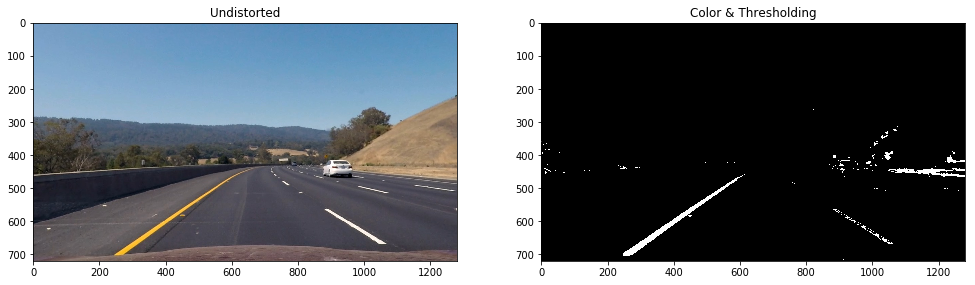

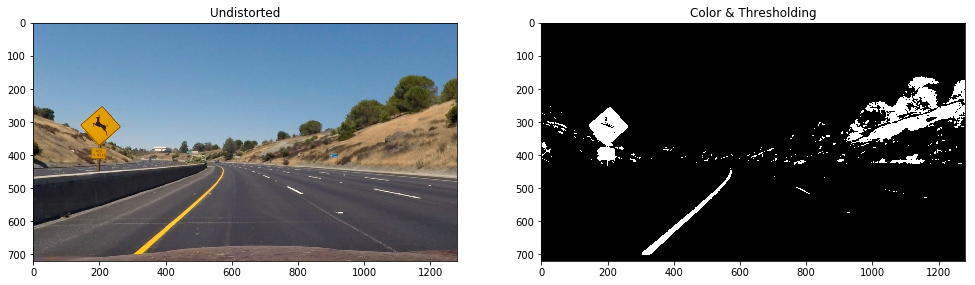

In [7]:
_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/test_images/test*.jpg')
#_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/Frames/error/*.jpg')

for fname in _imgfiles:
    imgTest=mpimg.imread(fname)
    dst=cv2.undistort(imgTest,mtx,dist,None,mtx)
    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    #gray = cv2.cvtColor(result, cv2.COLOR_RGB2GRAY) #grayscale conversion

    images=[dst,result]
    plt.figure(figsize=(20,10))
    columns = 3
    for i, image in enumerate(zip(['Undistorted','Color & Thresholding',\
                                   'Combined Gradient & Color thresholds'],images)):
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.imshow(image[1],cmap='gray')
        image_title=image[0]
        plt.title(image_title, fontsize=12)

# Defining a region of interest 

[200, 1080, 1080, 200, 200] [0, 0, 720, 720, 0]
[190, 585, 702, 1130, 190] [720, 455, 455, 720, 720]


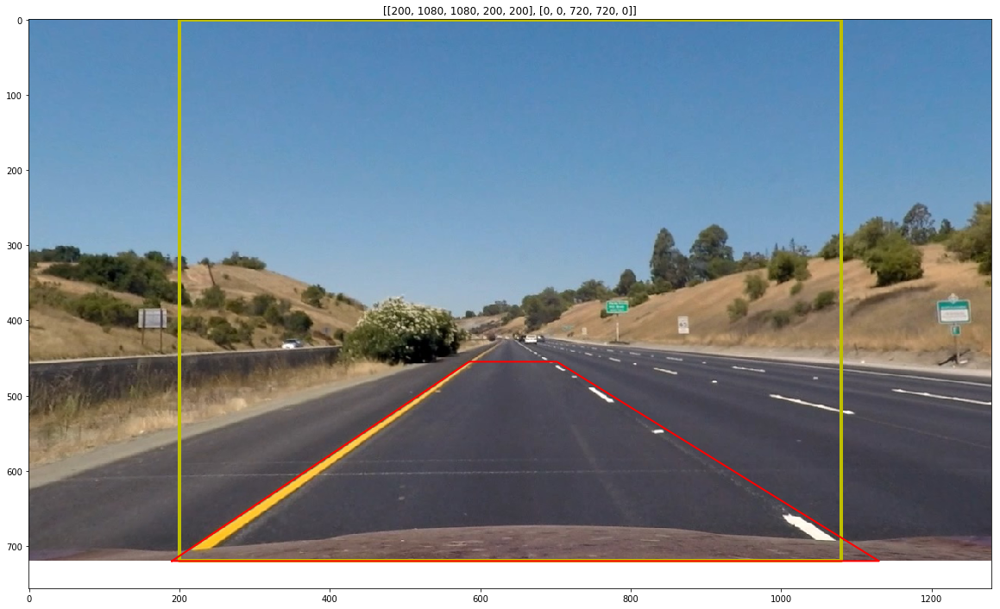

In [8]:
image=mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/straight_lines1.jpg')
dst=cv2.undistort(image,mtx,dist,None,mtx)    
plt.figure(figsize=(20,18))
plt.imshow(dst)

offset=200
x=[offset,1280-offset,1280-offset,offset,offset]
y=[0,0,720,720,0]

print(x,y)
plt.plot(x, y, 'y', lw=4)

plt.title([x,y])
x=[190,585,702,1130,190]
y=[720,455,455,720,720]

plt.plot(x, y, 'r', lw=2)
print(x,y)
plt.show()

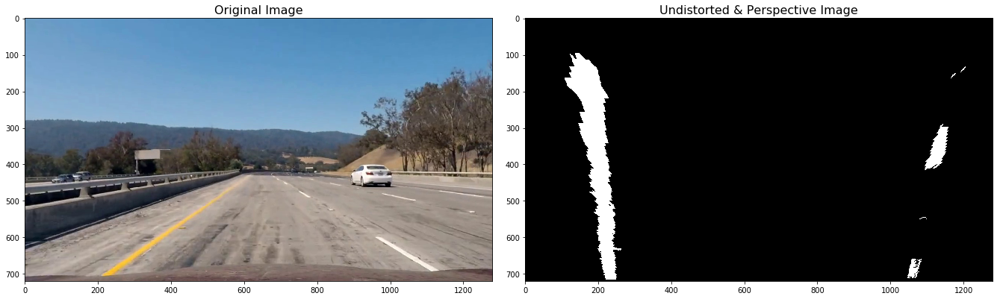

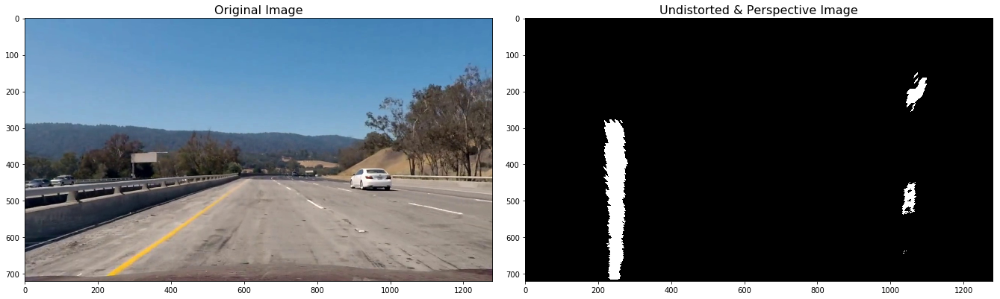

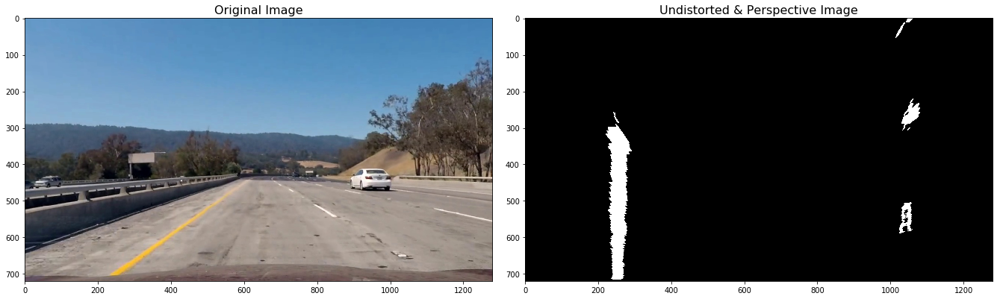

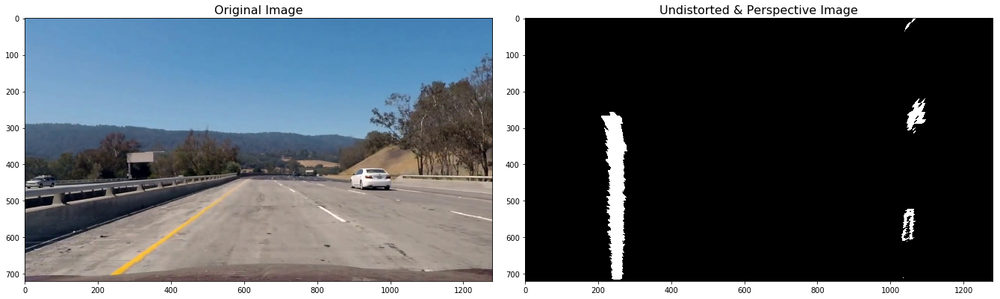

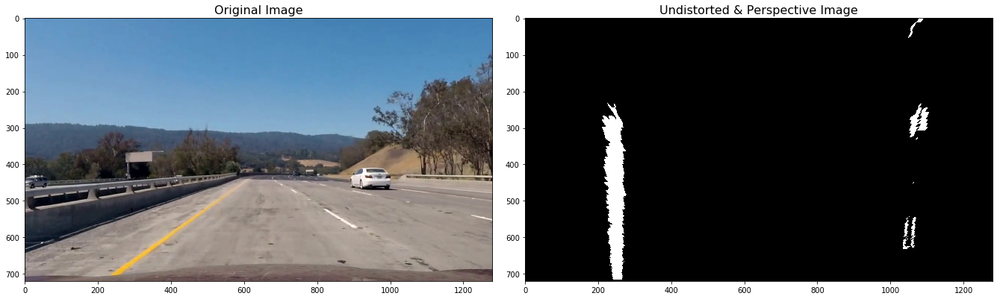

...

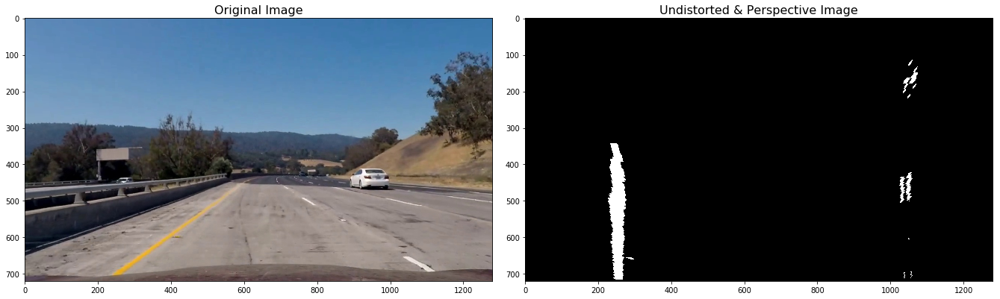

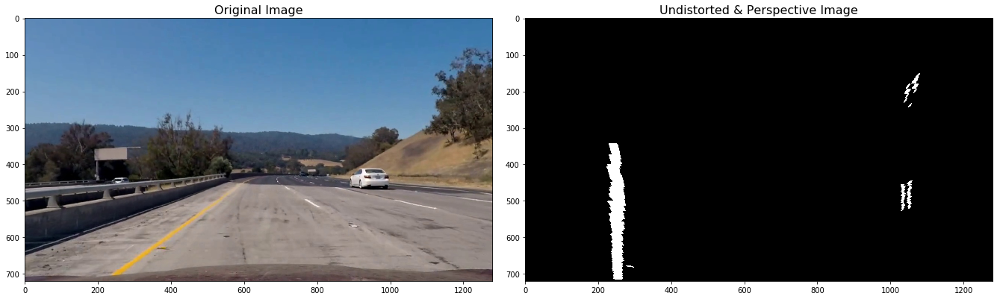

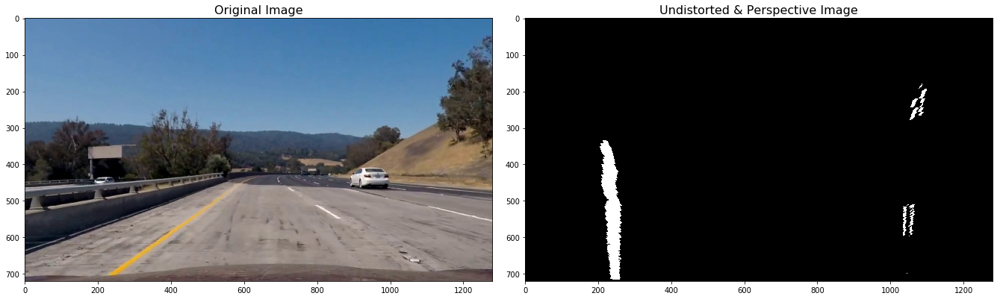

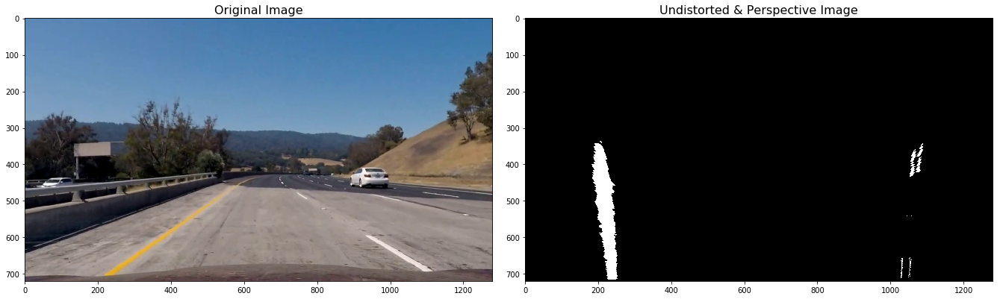

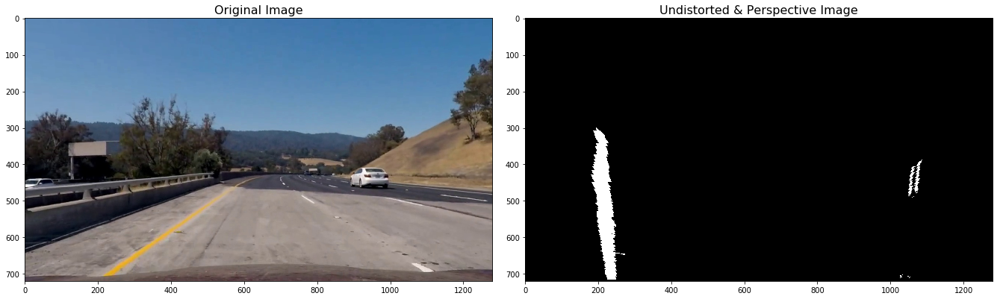

In [9]:
%matplotlib inline
#image=mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/straight_lines1.jpg')
_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/Frames/error/t*.jpg')
#_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/test_images/*.jpg')

_imgfiles.sort()
for fname in _imgfiles:
    image=mpimg.imread(fname)
    dst=cv2.undistort(image,mtx,dist,None,mtx)
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion    


    src_points=np.float32([[585,455],[702,455],[1200,720],[160,720]])
    #src_points=np.float32([[585,455],[705,455],[1130,720],[190,720]]) --testing window
    offset = 200 # offset for dst points

    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])

    dst_points = np.float32([[offset, 0],
                             [img_size[0]-offset, 0],
                             [img_size[0]-offset, img_size[1]],
                             [offset, img_size[1]]])
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    Minv = cv2.getPerspectiveTransform(dst_points, src_points) # is needed to finally place the lane marking on the image.

    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    
    warped = cv2.warpPerspective(result, M, img_size)#,flags=cv2.INTER_NEAREST)


    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 6))
    f.tight_layout()
    ax1.imshow(dst)
    ax1.set_title('Original Image', fontsize=16)
    x=[190,585,692,1130,190]
    y=[720,450,450,720,720]
    ax2.imshow(warped,cmap='gray')
    ax2.set_title('Undistorted & Perspective Image', fontsize=16)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)


# Eyeballing Undistorted, Color & Thresholded. and Perspective transformed images

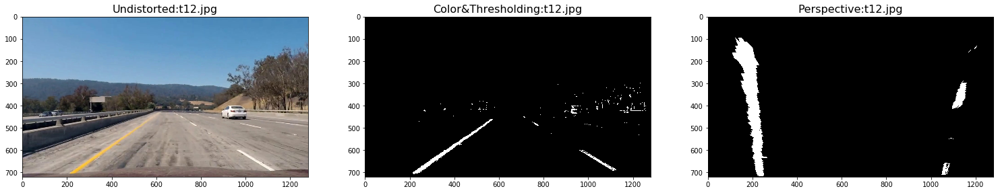

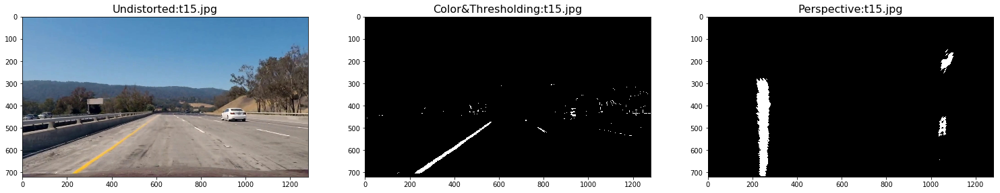

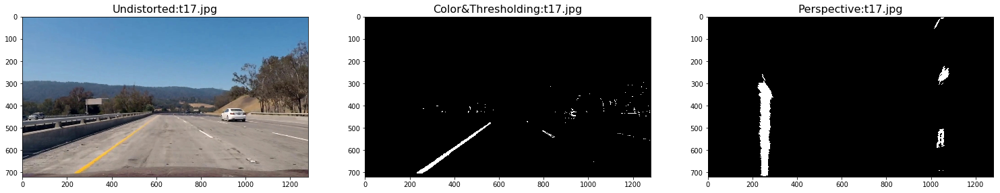

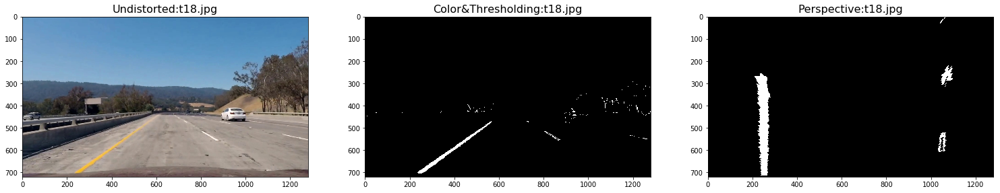

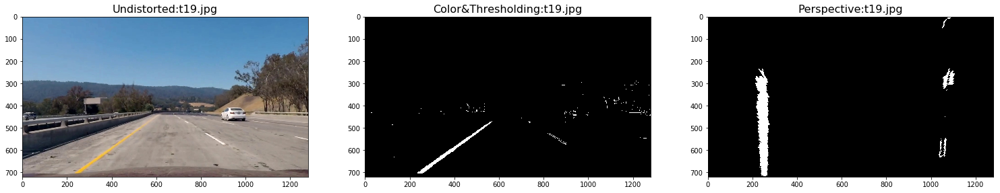

...

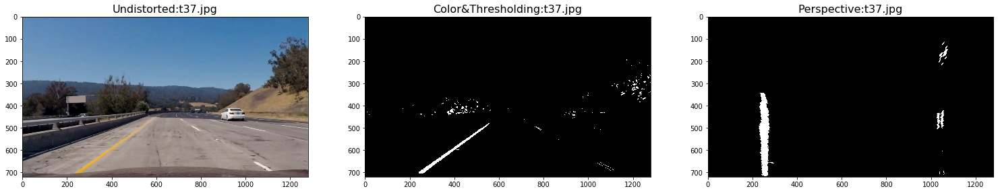

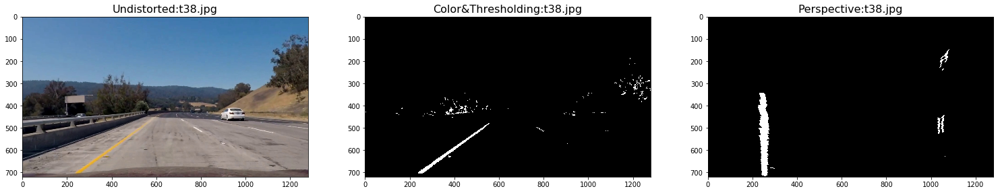

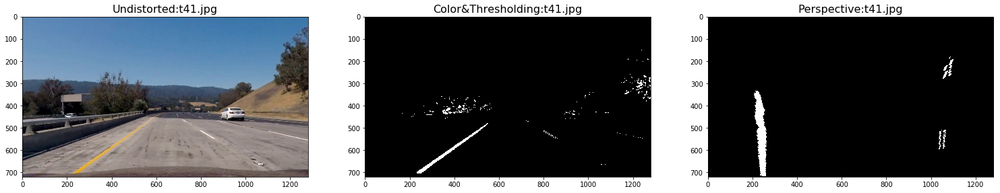

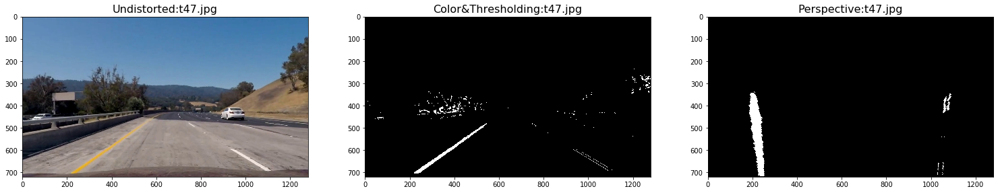

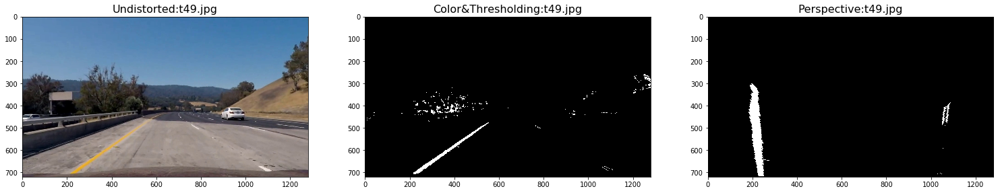

In [10]:
#_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/test_images/*.jpg')
_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/Frames/error/t*.jpg')
_imgfiles.sort()
for fname in _imgfiles:
    imgTest=mpimg.imread(fname)
    dst=cv2.undistort(imgTest,mtx,dist,None,mtx)
    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    #gray = cv2.cvtColor(result, cv2.COLOR_RGB2GRAY) #grayscale conversion
    
    src_points=np.float32([[585,455],[702,455],[1200,720],[160,720]]) #by trial and error method
    offset = 200 # offset for dst points

    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])
    dst_points = np.float32([[offset, 0],
                         [img_size[0]-offset, 0],
                         [img_size[0]-offset, img_size[1]],
                         [offset, img_size[1]]])
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    warped = cv2.warpPerspective(result, M, img_size)#,flags=cv2.INTER_NEAREST)
    
    images=[dst,result,warped]
    plt.figure(figsize=(20,10))
    columns = 3
    for i, image in enumerate(zip(['Undistorted:','Color&Thresholding:','Perspective:'],images)):
        plt.subplot(len(images) / columns + 1, columns, i + 1)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.imshow(image[1],cmap='gray')
        image_title=image[0]+fname.split('/')[4]
        plt.title(image_title, fontsize=16)
        

# Finding lane pixels using the binary warped image as an input.

## The function also uses horizontal sliding window in addition to vertical sliding window to find the minimum pixcels as the lane may be curving...

### Pending:Using blind man's approach in case we dont find any pixcel activation i.e. store last good known lane pixcels and extrapolate. 

In [11]:
def find_lane_pixels(binary_warped,nwindows = 9,margin = 110,minpix = 50):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = nwindows
    # Set the width of the windows +/- margin
    margin = margin
    # Set minimum number of pixels found to recenter window
    minpix = minpix

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    #print(window_height)
    
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        #print(binary_warped.shape[0],(window+1)*window_height, win_y_low,win_y_high)
        
        #Find the four below boundaries of the window 
        win_xleft_low = leftx_current  - margin 
        win_xleft_high = leftx_current + margin 
        win_xright_low = rightx_current- margin 
        win_xright_high = rightx_current + margin 
        
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2)
        #print('right',window,(win_xright_low,win_y_low),(win_xright_high,win_y_high))
        
        #Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                          &(nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                           &(nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        #If you found > minpix pixels, recenter next window
        #(`right` or `leftx_current`) on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
            #last_goodknown_leftx=np.int(np.mean(nonzerox[good_left_inds]))
        else:
            #trying horizontal sliding window to find the minimum pixcels as the lane may be curving...
            for i in range(0,3,1):
                win_xleft_low =  win_xleft_high-margin
                win_xleft_high = win_xleft_high+margin
                cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,0,255), 2)
                good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                          &(nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]                
                left_lane_inds.append(good_left_inds)
                if len(good_left_inds) > minpix:
                    leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
                    break
            
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
            #last_goodknown_rightx=np.int(np.mean(nonzerox[good_right_inds]))
            #last_goodknown_windowright=(win_xright_low,win_xright_high) #storing last good known window
        else:
            #trying horizontal sliding window to find the minimum pixcels as the lane may be curving...
            for i in range(0,3,1):
                win_xright_low =  win_xright_high-margin
                win_xright_high = win_xright_high+margin
                cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,0,255), 2)
                #print('else',(win_xright_low,win_y_low),(win_xright_high,win_y_high))
                good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high)
                           &(nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
                right_lane_inds.append(good_right_inds)
                if len(good_right_inds) > minpix:
                    rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
                    break
    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass
    
    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
        
    return leftx, lefty, rightx, righty, out_img

# Using polynomial fit math to fit left and right lane lines based on the pixcel activation. 

In [12]:
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

def fit_polynomial(binary_warped):
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped)

    #Fit a second order polynomial to each using `np.polyfit` #
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    #print(left_fit,right_fit
    
    #Fit a second order polynomial to each lane line using np.ployfit for the real world dataset
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='yellow')

    #return left_fit,right_fit,left_fitx,right_fitx,ploty,out_img
    return left_fit,right_fit,left_fitx,right_fitx,left_fit_cr,right_fit_cr,ploty,out_img

# Testing find lane pixcel and radius on test and error farmes

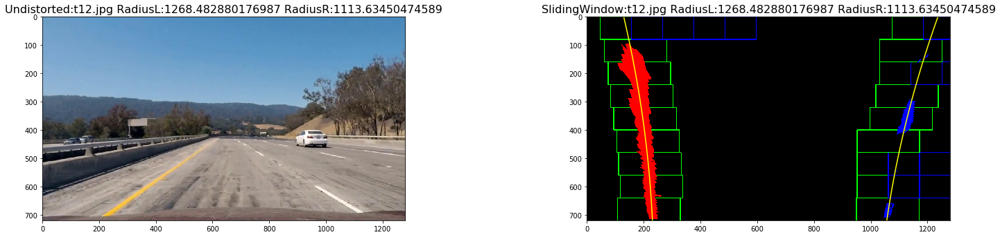

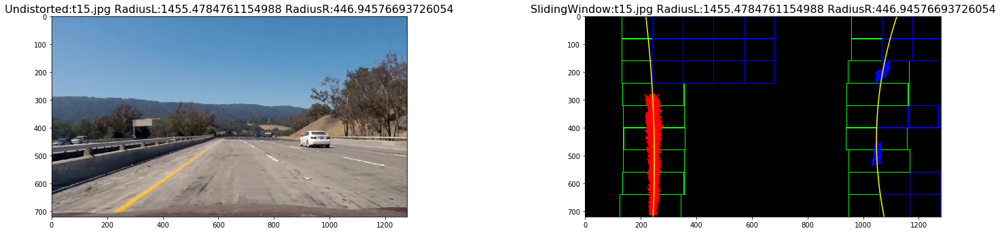

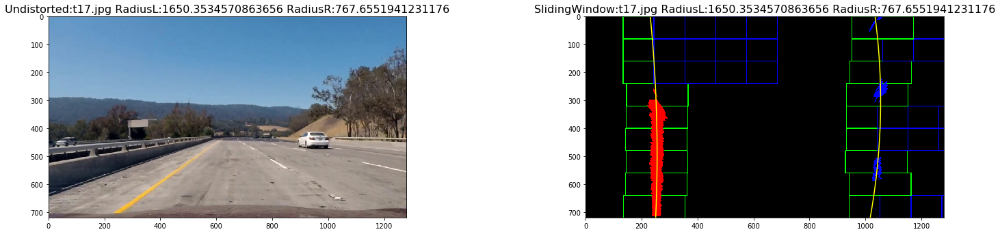

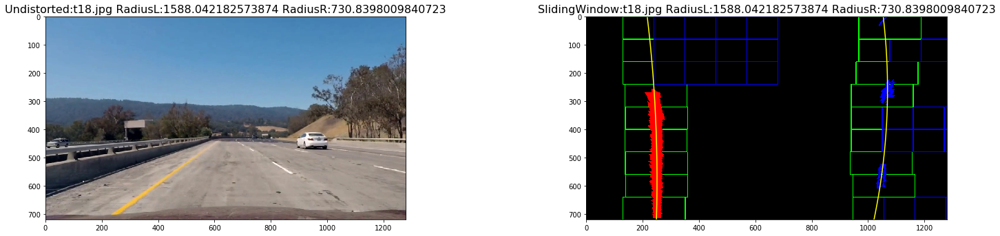

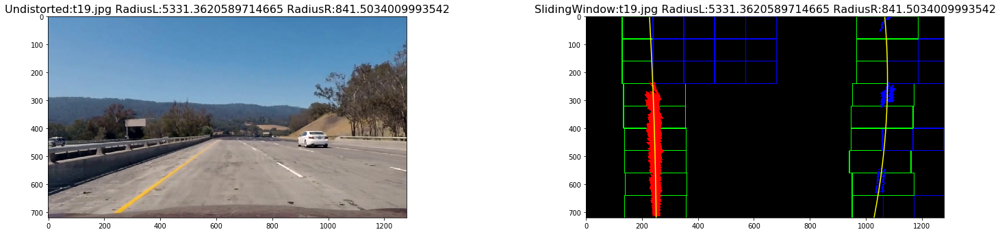

...

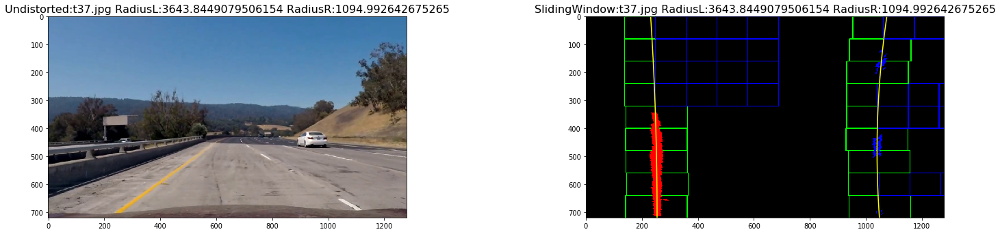

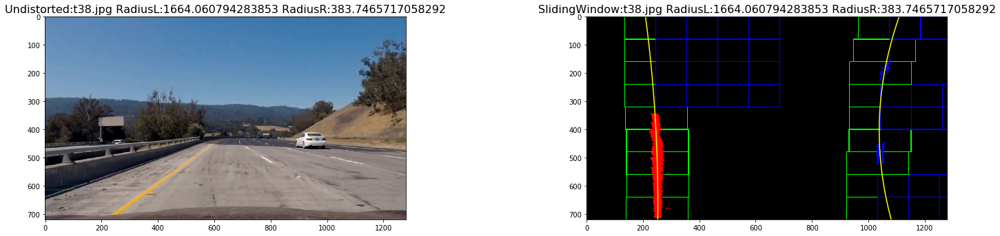

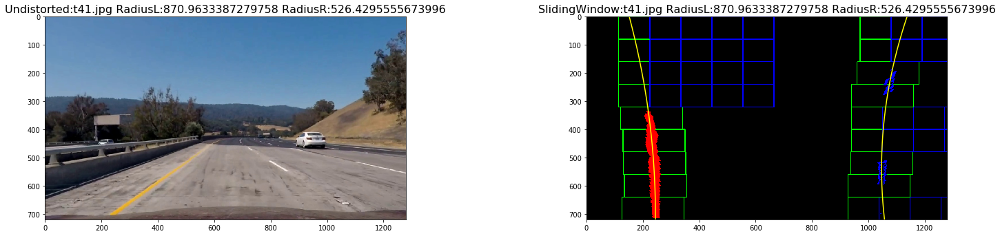

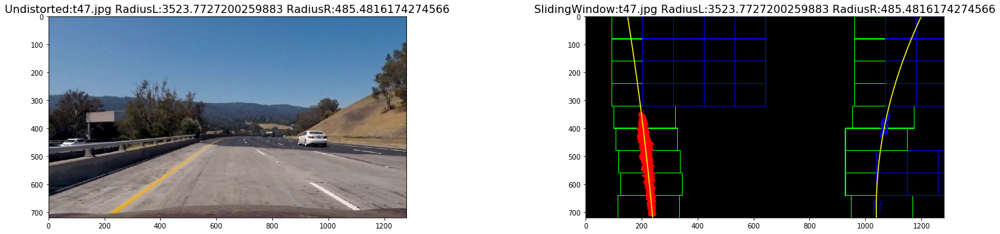

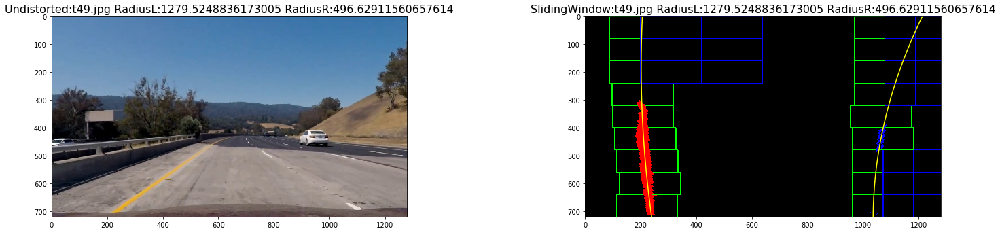

In [13]:
%matplotlib inline
#_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/test_images/*.jpg')
_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/Frames/error/t*.jpg')
_imgfiles.sort()

for fname in _imgfiles:
    image=mpimg.imread(fname)
    #image=mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/straight_lines2.jpg')
    dst=cv2.undistort(image,mtx,dist,None,mtx)    
    
    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    
    
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion
    

    src_points=np.float32([[585,455],[702,455],[1200,720],[160,720]]) #by trial and error method
    offset = 200 # offset for dst points

    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])
    dst_points = np.float32([[offset, 0],
                         [img_size[0]-offset, 0],
                         [img_size[0]-offset, img_size[1]],
                         [offset, img_size[1]]])
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    binary_warped = cv2.warpPerspective(result, M, img_size)#,flags=cv2.INTER_NEAREST)
    #left_fit,right_fit,left_fitx,right_fitx,ploty,out_img = fit_polynomial(binary_warped) 
    left_fit,right_fit,left_fitx,right_fitx,left_fit_cr,right_fit_cr,ploty,out_img= fit_polynomial(binary_warped)
    
    
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5)/ np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])    
    #print('Image:{}, Left : {:.2f} km, Right : {:.2f} km'.format(fname.split('/')[3], left_curverad, right_curverad))
    
    #visualization of dataset
    _images=[dst,out_img]
    plt.figure(figsize=(20,10))
    columns = 2
    for i, __image in enumerate(zip(['Undistorted:','SlidingWindow:'],_images)):
        plt.subplot(len(_images) / columns + 1, columns, i + 1)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.imshow(__image[1],cmap='gray')
        image_title=__image[0]+fname.split('/')[4] +" RadiusL:"+str(left_curverad) +' RadiusR:'+str(right_curverad)
        plt.title(image_title, fontsize=16)
        
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
        

# Building a helper function to draw lane image on the original undistorted image

In [14]:
def drawLaneImage(warped, left_fit, right_fit,Minv):
    # Create an image to draw the lines on
    ploty = np.linspace(0, warped.shape[0] - 1, warped.shape[0])    
    color_warp = np.zeros_like(warped).astype(np.uint8)
    #color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Calculate points.
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))
    
    # Draw the lane onto the warped blank image
    _=cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
    
    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (warped.shape[1], warped.shape[0])) 
    return cv2.addWeighted(warped, 1, newwarp, 0.3, 0)

# Testing the entire pipeline and adding vehicle center and finally transposing the lane image using camera inverse matrix to the original image

## Please note these assumptions:
1. Camera is mounted exacletly on the center of the car! Not possible in real world
2. Camera is mounted on a horizontal plane, again not possible in the real world
3. Car wheels are prefectly aligned!

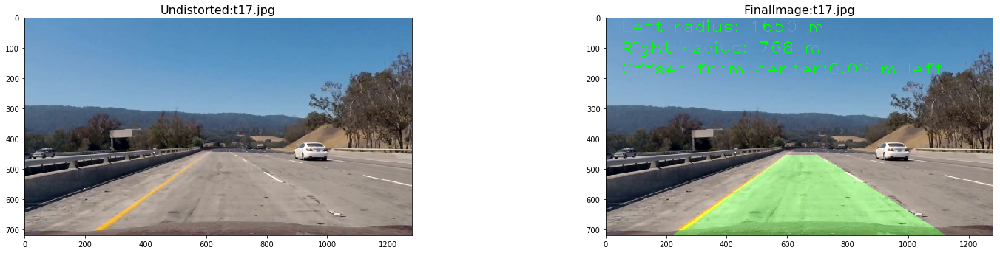

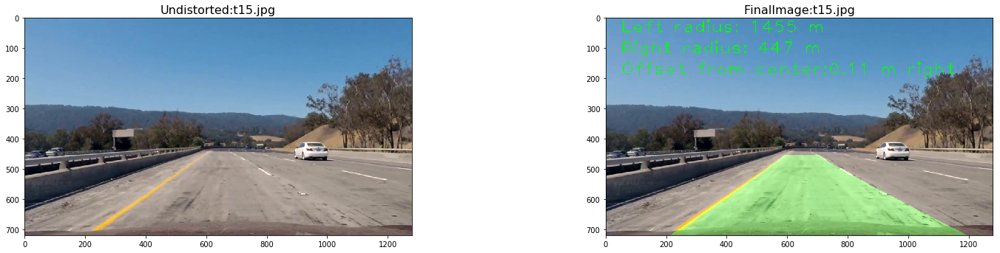

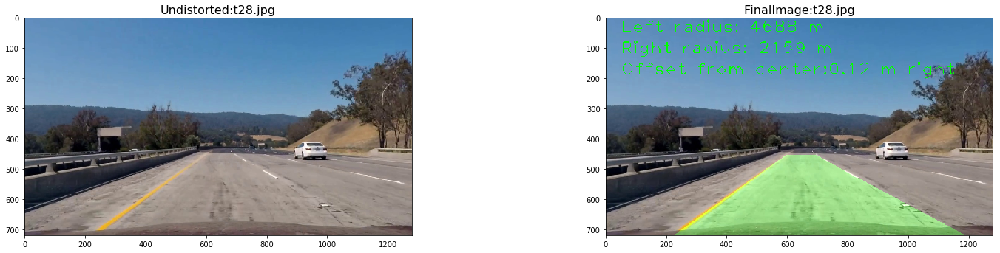

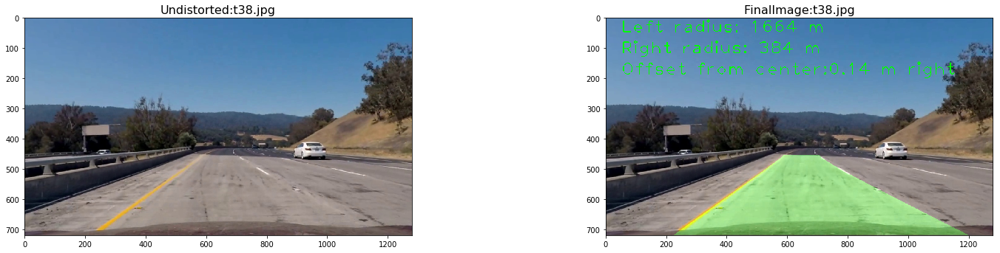

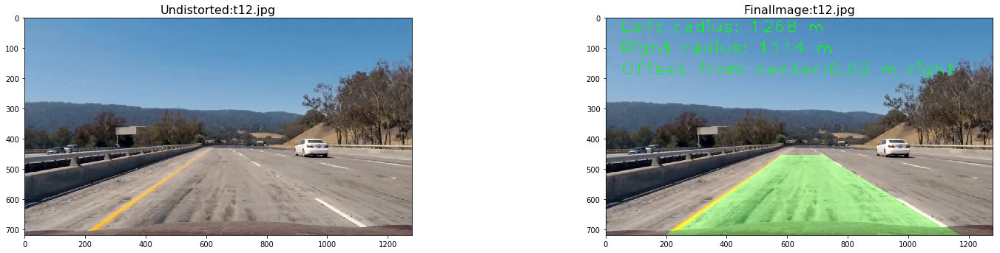

...

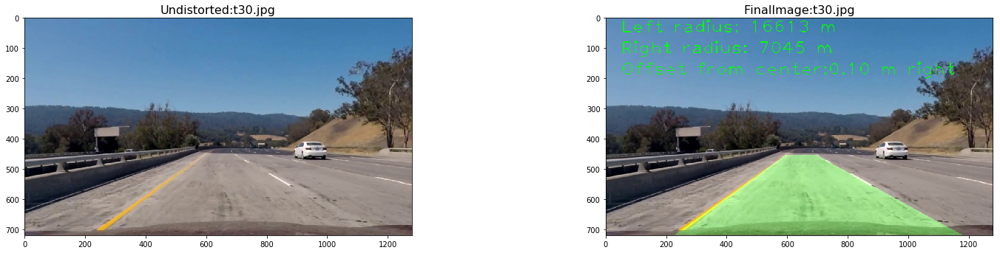

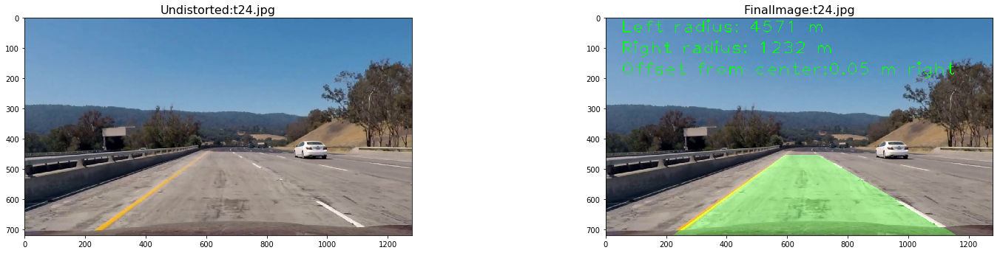

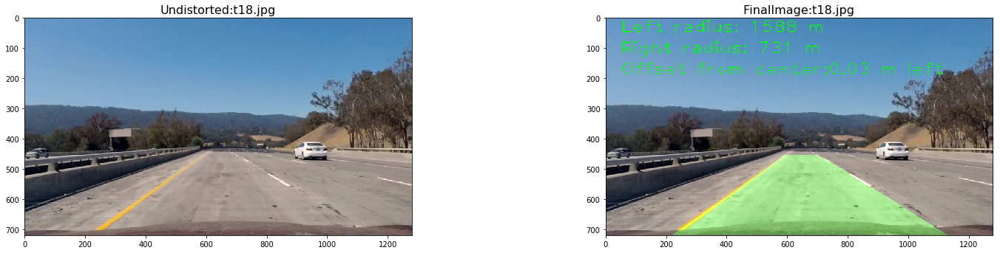

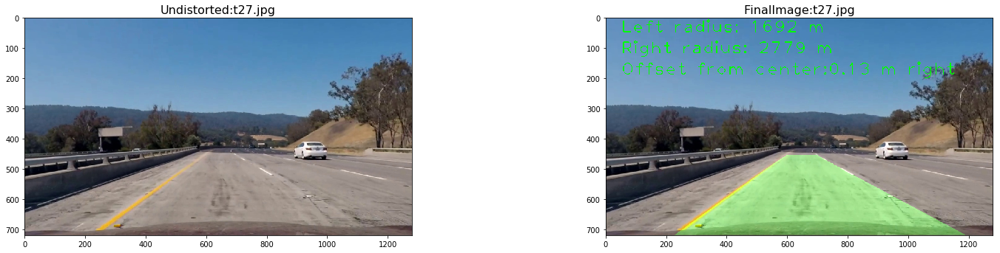

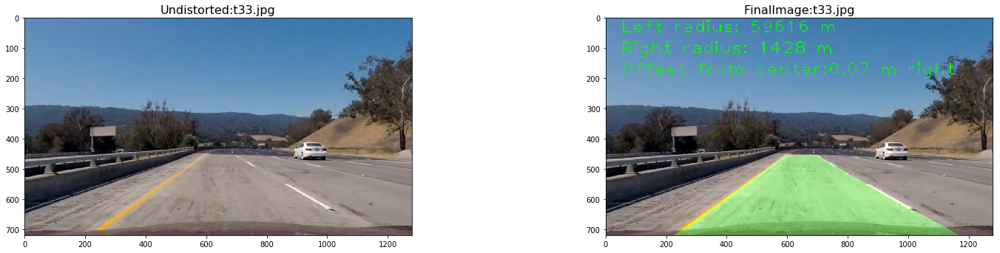

In [15]:
%matplotlib inline
# Define conversions in x and y from pixels space to meters
ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meters per pixel in x dimension

#_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/test_images/*.jpg')
_imgfiles= glob.glob('../CarND-Advanced-Lane-Lines/Frames/error/*.jpg')

for fname in _imgfiles:
    image=mpimg.imread(fname)
    #image=mpimg.imread('../CarND-Advanced-Lane-Lines/test_images/straight_lines2.jpg')
    dst=cv2.undistort(image,mtx,dist,None,mtx)
    
    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion

    src_points=np.float32([[585,455],[702,455],[1200,720],[160,720]]) #by trial and error method
    offset = 200 # offset for dst points

    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])
    dst_points = np.float32([[offset, 0],
                         [img_size[0]-offset, 0],
                         [img_size[0]-offset, img_size[1]],
                         [offset, img_size[1]]])
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    binary_warped = cv2.warpPerspective(result, M, img_size)#,flags=cv2.INTER_NEAREST)
    #left_fit,right_fit,left_fitx,right_fitx,ploty,out_img = fit_polynomial(binary_warped)
    left_fit,right_fit,left_fitx,right_fitx,left_fit_cr,right_fit_cr,ploty,out_img= fit_polynomial(binary_warped)    
    
    # this function takes the camare matrix inverse for transposing the lane image on the original image 
    output = drawLaneImage(dst, left_fit, right_fit,Minv)
    
    # Calculate curvature
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)
    
    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5)/ np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])    
    
    # Calculate vehicle center
    _xmax = img.shape[1]*xm_per_pix
    _ymax = img.shape[0]*ym_per_pix
    
    vehicleCenter = _xmax / 2 #one big assumption
    lineLeft = left_fit_cr[0]*_ymax**2 + left_fit_cr[1]*_ymax + left_fit_cr[2]
    lineRight = right_fit_cr[0]*_ymax**2 + right_fit_cr[1]*_ymax + right_fit_cr[2]
    lineMiddle = lineLeft + (lineRight - lineLeft)/2 # based on 1st assumption!
    offsetFromVehicle = lineMiddle - vehicleCenter
    
    if offsetFromVehicle > 0:
        message = '{:.2f} m right'.format(offsetFromVehicle)
    else:
        message = '{:.2f} m left'.format(-offsetFromVehicle)

    # Draw info
    font = cv2.FONT_HERSHEY_PLAIN
    fontColor = (0, 255, 0)
    cv2.putText(output, 'Left radius: {:.0f} m'.format(left_curverad), (50, 50), font, 4, fontColor, 2)
    cv2.putText(output, 'Right radius: {:.0f} m'.format(right_curverad), (50, 120), font, 4, fontColor, 2)
    cv2.putText(output, 'Offset from center:{}'.format(message), (50, 190), font, 4, fontColor, 2)
    

    #visualization of dataset
    _images=[dst,output]
    plt.figure(figsize=(20,10))
    columns = 2
    for i, __image in enumerate(zip(['Undistorted:','FinalImage:'],_images)):
        plt.subplot(len(_images) / columns + 1, columns, i + 1)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        plt.imshow(__image[1])
        image_title=__image[0]+fname.split('/')[4]
        plt.title(image_title, fontsize=16)
    

# Creating video pipeline based on our analysis and design 

In [16]:
from moviepy.editor import VideoFileClip

## A line class is defined to keep track of last detections of the lane lines and radius so that we can use that to check new detections. 

In [17]:
class _line():
    def __init__(self):
        self.left_fit = None
        self.right_fit = None
        self.left_fit_cr = None
        self.right_fit_cr = None
        self.left_curverad = None
        self.right_curverad = None

## Building a final process image function to integrate all pipeline

In [18]:
_leftLane = _line() # to keep track of left line dataset
_rightLane = _line() # to keep track of right line dataset

def process_image(image):
    dst=cv2.undistort(image,mtx,dist,None,mtx)    
    
    result = color_sobal_gradientthresholding(dst,\
                                              h_thresh=[15, 100],\
                                              s_thresh=[90, 255],\
                                              R_thresh = [200, 255], sx_thresh=[20, 100])
    
    gray = cv2.cvtColor(dst, cv2.COLOR_RGB2GRAY) #grayscale conversion

    src_points=np.float32([[585,455],[702,455],[1200,720],[160,720]]) #by trial and error method
    offset = 200 # offset for dst points

    # Grab the image shape
    img_size = (gray.shape[1], gray.shape[0])
    dst_points = np.float32([[offset, 0],
                         [img_size[0]-offset, 0],
                         [img_size[0]-offset, img_size[1]],
                         [offset, img_size[1]]])
    M = cv2.getPerspectiveTransform(src_points, dst_points)
    binary_warped = cv2.warpPerspective(result, M, img_size)#,flags=cv2.INTER_NEAREST)
    #left_fit,right_fit,left_fitx,right_fitx,ploty,out_img = fit_polynomial(binary_warped)
    left_fit,right_fit,left_fitx,right_fitx,left_fit_cr,right_fit_cr,ploty,out_img= fit_polynomial(binary_warped)    
    
    # this function takes the camare matrix inverse for transposing the lane image on the original image 
    output = drawLaneImage(dst, left_fit, right_fit,Minv)    

    # Calculate curvature
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    y_eval = np.max(ploty)

    # Calculation of R_curve (radius of curvature)
    left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5)/ np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])    
    
    # Calculate vehicle center
    xMax = img.shape[1]*xm_per_pix
    yMax = img.shape[0]*ym_per_pix
    vehicleCenter = xMax / 2 #one big assumtion
    lineLeft = left_fit_cr[0]*yMax**2 + left_fit_cr[1]*yMax + left_fit_cr[2]
    lineRight = right_fit_cr[0]*yMax**2 + right_fit_cr[1]*yMax + right_fit_cr[2]
    lineMiddle = lineLeft + (lineRight - lineLeft)/2 # based on 1st assumption!
    offsetFromVehicle = lineMiddle - vehicleCenter
    
    if offsetFromVehicle > 0:
        message = '{:.2f} m right'.format(offsetFromVehicle)
    else:
        message = '{:.2f} m left'.format(-offsetFromVehicle)    
    
    if left_curverad > 10000:
        left_fit = _leftLane.left_fit
        left_fit_cr = _leftLane.left_fit_cr
        left_curverad = _leftLane.left_curverad
    else:
        _leftLane.left_fit = left_fit
        _leftLane.left_fit_cr = left_fit_cr
        _leftLane.left_curverad = left_curverad    
    if right_curverad > 10000:
        right_fit = _rightLane.right_fit
        right_fit_cr = _rightLane.right_fit_cr
        right_curverad = _rightLane.right_curverad
    else:
        _rightLane.right_fit = right_fit
        _rightLane.right_fit_cr = right_fit_cr
        _rightLane.right_curverad = right_curverad

    # Draw info
    font = cv2.FONT_HERSHEY_PLAIN
    fontColor = (0, 255, 0)
    cv2.putText(output, 'Left radius: {:.0f} m'.format(left_curverad), (50, 50), font, 4, fontColor, 2)
    cv2.putText(output, 'Right radius: {:.0f} m'.format(right_curverad), (50, 120), font, 4, fontColor, 2)
    cv2.putText(output, 'Offset from center:{}'.format(message), (50, 190), font, 4, fontColor, 2)
    return output


# Running the piple on a video stream.

In [ ]:
challenge_output = '../CarND-Advanced-Lane-Lines/output_images/AdvancedLaneLinesV9.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip3 = VideoFileClip('test_videos/challenge.mp4').subclip(.11,.27)
clip3 = VideoFileClip('../CarND-Advanced-Lane-Lines/project_video.mp4')
challenge_clip = clip3.fl_image(process_image)
challenge_clip.write_videofile(challenge_output, audio=False,verbose=False)

In [ ]:
#This step is done only to get few frames from the challlenge video for testing the pipeline
from moviepy.video.io.VideoFileClip import VideoFileClip
input_video_path = '../CarND-Advanced-Lane-Lines/project_video.mp4'
output_video_path = 't.mp4'

with VideoFileClip(input_video_path) as video:
    new = video.subclip(22, 25)
    new.write_videofile(output_video_path)

#This step is done only to get few frames from the challlenge video for testing the pipeline
vidcap = cv2.VideoCapture('../CarND-Advanced-Lane-Lines/t.mp4')
success,image = vidcap.read()
count = 0
success = True
while success:
  cv2.imwrite("../CarND-Advanced-Lane-Lines/Frames/t%d.jpg" % count, image)     # save frame as .JPG file      
  success,image = vidcap.read()
  count += 1

# Testing the pipleine on harder challange video

In [ ]:
challenge_output = '../CarND-Advanced-Lane-Lines/output_images/harder_challenge_videoV2.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
#clip3 = VideoFileClip('test_videos/challenge.mp4').subclip(.11,.27)
clip3 = VideoFileClip('../CarND-Advanced-Lane-Lines/harder_challenge_video.mp4')
challenge_clip = clip3.fl_image(process_image)
%time challenge_clip.write_videofile(challenge_output, audio=False)

# Issues:
1. Original version of the video pipeline was failing to detect lane markings in varied lighting conditions ex. shadows, alien markings,miss alignment etc.
2. The pipeline was also failing to detect if the road top is not blacktop like bridges.

Solution:
1. Testing R, S and H channels to find lane lines
2. Added horizontal sliding window if vertical is not able to find lane lines


# Next steps:
1. Implement smoothing and use of last good known markings
2. Implement lane marking if there is no lane markings 